# **LAB 4 - PART 1 Classification with KNN, Decision Tree and Random Forest**

In [47]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn import preprocessing
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.neighbors import KNeighborsClassifier 
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
pd.options.display.float_format = '{:.3f}'.format

#### **Read csv file**
Select only `['Total.Cup.Points', 'Species','Country.of.Origin','Processing.Method', 'Aroma', 'Flavor', 'Aftertaste','Acidity','Body', 'Balance', 'Uniformity', 'Moisture', 'altitude_mean_meters']`

In [48]:
### START CODE HERE ###
df = pd.read_csv("./Coffee-modified.csv")
df = df[['Total.Cup.Points', 'Species','Country.of.Origin','Processing.Method', 'Aroma', 'Flavor', 'Aftertaste','Acidity','Body', 'Balance', 'Uniformity', 'Moisture', 'altitude_mean_meters']]
### END CODE HERE ###


In [49]:
df.columns
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1311 entries, 0 to 1310
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Total.Cup.Points      1311 non-null   float64
 1   Species               1311 non-null   object 
 2   Country.of.Origin     1310 non-null   object 
 3   Processing.Method     1159 non-null   object 
 4   Aroma                 1311 non-null   float64
 5   Flavor                1311 non-null   float64
 6   Aftertaste            1311 non-null   float64
 7   Acidity               1311 non-null   float64
 8   Body                  1311 non-null   float64
 9   Balance               1311 non-null   float64
 10  Uniformity            1311 non-null   float64
 11  Moisture              1311 non-null   float64
 12  altitude_mean_meters  1082 non-null   float64
dtypes: float64(10), object(3)
memory usage: 133.3+ KB


**Drop NA**


In [50]:
### START CODE HERE ###
df.dropna(inplace=True)
### END CODE HERE ###
df.info()
df.describe()

<class 'pandas.core.frame.DataFrame'>
Index: 1003 entries, 0 to 1309
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Total.Cup.Points      1003 non-null   float64
 1   Species               1003 non-null   object 
 2   Country.of.Origin     1003 non-null   object 
 3   Processing.Method     1003 non-null   object 
 4   Aroma                 1003 non-null   float64
 5   Flavor                1003 non-null   float64
 6   Aftertaste            1003 non-null   float64
 7   Acidity               1003 non-null   float64
 8   Body                  1003 non-null   float64
 9   Balance               1003 non-null   float64
 10  Uniformity            1003 non-null   float64
 11  Moisture              1003 non-null   float64
 12  altitude_mean_meters  1003 non-null   float64
dtypes: float64(10), object(3)
memory usage: 109.7+ KB


,Total.Cup.Points,Aroma,Flavor,Aftertaste,Acidity,Body,Balance,Uniformity,Moisture,altitude_mean_meters
count,1003.000,1003.000,1003.000,1003.000,1003.000,1003.000,1003.000,1003.000,1003.000,1003.000
mean,82.127,7.567,7.514,7.386,7.526,7.504,7.499,9.870,0.095,1816.792
std,2.632,0.301,0.324,0.333,0.308,0.273,0.341,0.445,0.043,9112.473
min,59.830,5.080,6.170,6.170,5.250,6.330,6.080,6.000,0.000,1.000
25%,81.170,7.420,7.330,7.170,7.330,7.330,7.330,10.000,0.100,1100.000
50%,82.420,7.580,7.500,7.420,7.500,7.500,7.500,10.000,0.110,1310.640
75%,83.580,7.750,7.670,7.580,7.670,7.670,7.670,10.000,0.120,1600.000
max,90.580,8.750,8.830,8.670,8.750,8.500,8.580,10.000,0.170,190164.000


In [51]:
df.describe()

,Total.Cup.Points,Aroma,Flavor,Aftertaste,Acidity,Body,Balance,Uniformity,Moisture,altitude_mean_meters
count,1003.000,1003.000,1003.000,1003.000,1003.000,1003.000,1003.000,1003.000,1003.000,1003.000
mean,82.127,7.567,7.514,7.386,7.526,7.504,7.499,9.870,0.095,1816.792
std,2.632,0.301,0.324,0.333,0.308,0.273,0.341,0.445,0.043,9112.473
min,59.830,5.080,6.170,6.170,5.250,6.330,6.080,6.000,0.000,1.000
25%,81.170,7.420,7.330,7.170,7.330,7.330,7.330,10.000,0.100,1100.000
50%,82.420,7.580,7.500,7.420,7.500,7.500,7.500,10.000,0.110,1310.640
75%,83.580,7.750,7.670,7.580,7.670,7.670,7.670,10.000,0.120,1600.000
max,90.580,8.750,8.830,8.670,8.750,8.500,8.580,10.000,0.170,190164.000


Let's `Y` be  `Total.Cup.Points` and X be the rest except in  `Y`.

In [52]:
### START CODE HERE ###
Y = df[["Total.Cup.Points"]]
X = df.drop(["Total.Cup.Points"], axis=1)
### END CODE HERE ###

<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- X : `['Species', 'Country.of.Origin', 'Processing.Method', 'Aroma', 'Flavor','Aftertaste', 'Acidity', 'Body', 'Balance', 'Uniformity', 'Moisture','altitude_mean_meters']`
- Y : `['Total.Cup.Points']`

</details>

In [53]:
print(X.columns)
print(Y.columns)

Index(['Species', 'Country.of.Origin', 'Processing.Method', 'Aroma', 'Flavor',
       'Aftertaste', 'Acidity', 'Body', 'Balance', 'Uniformity', 'Moisture',
       'altitude_mean_meters'],
      dtype='object')
Index(['Total.Cup.Points'], dtype='object')


**Labeling Bean_grade value using percentile**

- Bean_grade = 1 ; `if Y < rating_pctile[0] 75 percentile`
- Bean_grade = 2 ; `if rating_pctile[0] <= Y < rating_pctile[1] 90 percentile`
- Bean_grade = 3 ; `if Y >= rating_pctile[1]`

<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>
<br>

|       |   Bean_grade |
|-------|--------------|
| count | 1003.000000  |
| mean  | 1.360917     |
| std   | 0.663677     |
| min   | 1.000000     |
| 25%   | 1.000000     |
| 50%   | 1.000000     |
| 75%   | 2.000000     |
| max   | 3.000000     |

</details>

In [54]:
### START CODE HERE ###
rating_pctile = [Y["Total.Cup.Points"].quantile(0.75), Y["Total.Cup.Points"].quantile(0.9)]
print(rating_pctile)
Y.loc[Y["Total.Cup.Points"] < rating_pctile[0], "Bean_grade"] = 1
Y.loc[(Y["Total.Cup.Points"] >= rating_pctile[0]) & (Y["Total.Cup.Points"] < rating_pctile[1]), "Bean_grade"] = 2
Y.loc[Y["Total.Cup.Points"] >= rating_pctile[1], "Bean_grade"] = 3
Y["Bean_grade"] = Y["Bean_grade"].astype(int)
### END CODE HERE ###
Y.describe()

[83.58, 84.58]


/tmp/ipykernel_28946/2764913216.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y.loc[Y["Total.Cup.Points"] < rating_pctile[0], "Bean_grade"] = 1
/tmp/ipykernel_28946/2764913216.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y["Bean_grade"] = Y["Bean_grade"].astype(int)


,Total.Cup.Points,Bean_grade
count,1003.000,1003.000
mean,82.127,1.361
std,2.632,0.664
min,59.830,1.000
25%,81.170,1.000
50%,82.420,1.000
75%,83.580,2.000
max,90.580,3.000


**Plot Bar graph that show count of each `Bean_grade`.**
<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical.

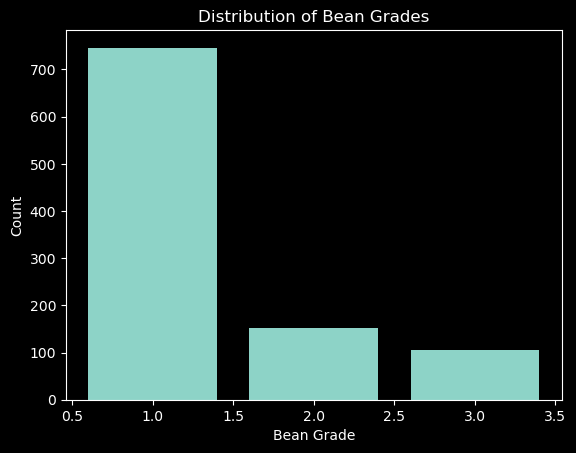

</details>

<Axes: xlabel='Bean_grade'>

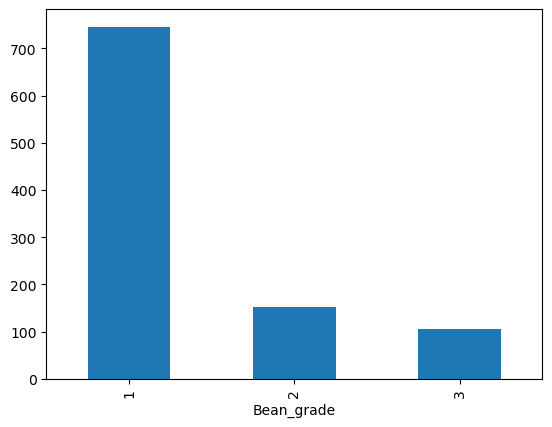

In [55]:
### START CODE HERE ###
Y["Bean_grade"].value_counts().plot(kind='bar')
### END CODE HERE ###

**Standardize X's numeric data**

<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical.

|       |   Aroma |   Flavor |   Aftertaste |   Acidity |   Body |   Balance |   Uniformity |   Moisture |   altitude_mean_meters |
|-------|---------|----------|--------------|-----------|--------|-----------|--------------|------------|------------------------|
| count | 1003.000| 1003.000 | 1003.000     | 1003.000  | 1003.000| 1003.000  | 1003.000     | 1003.000   | 1003.000               |
| mean  | -0.000  | 0.000    | -0.000       | -0.000    | -0.000 | -0.000    | -0.000       | -0.000     | -0.000                 |
| std   | 1.000   | 1.000    | 1.000        | 1.000     | 1.000  | 1.000     | 1.000        | 1.000      | 1.000                  |
| min   | -8.258  | -4.143   | -3.655       | -7.398    | -4.306 | -4.167    | -8.694       | -2.186     | -0.199                 |
| 25%   | -0.490  | -0.567   | -0.648       | -0.638    | -0.639 | -0.497    | 0.292        | 0.115      | -0.079                 |
| 50%   | 0.042   | -0.042   | 0.103        | -0.085    | -0.016 | 0.002     | 0.292        | 0.346      | -0.056                 |
| 75%   | 0.606   | 0.482    | 0.584        | 0.467     | 0.608  | 0.501     | 0.292        | 0.576      | -0.024                 |
| max   | 3.926   | 4.058    | 3.862        | 3.978     | 3.651  | 3.173     | 0.292        | 1.727      | 20.679                 |

</details>



In [56]:
### START CODE HERE ###
from sklearn.preprocessing import StandardScaler  

scaler = StandardScaler()
numeric_features = X.select_dtypes(include=[np.number]).columns
X[numeric_features] = scaler.fit_transform(X[numeric_features])
X.describe()

### END CODE HERE ###

,Aroma,Flavor,Aftertaste,Acidity,Body,Balance,Uniformity,Moisture,altitude_mean_meters
count,1003.000,1003.000,1003.000,1003.000,1003.000,1003.000,1003.000,1003.000,1003.000
mean,-0.000,0.000,-0.000,-0.000,-0.000,-0.000,-0.000,-0.000,-0.000
std,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
min,-8.258,-4.143,-3.655,-7.398,-4.306,-4.167,-8.694,-2.186,-0.199
25%,-0.490,-0.567,-0.648,-0.638,-0.639,-0.497,0.292,0.115,-0.079
50%,0.042,-0.042,0.103,-0.085,-0.016,0.002,0.292,0.346,-0.056
75%,0.606,0.482,0.584,0.467,0.608,0.501,0.292,0.576,-0.024
max,3.926,4.058,3.862,3.978,3.651,3.173,0.292,1.727,20.679


**Drop the columns that have correlation more than 0.8.**

DROPPED {'Flavor'}


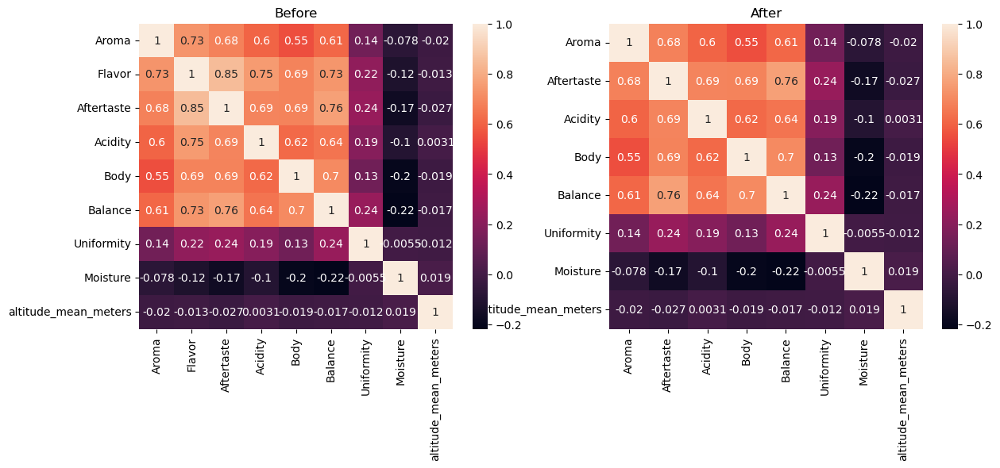

In [57]:
### START CODE HERE ###
import seaborn as sns
fig, axs = plt.subplots(ncols=2, figsize=(14, 5))  # Create a figure with two subplots
X_numeric = X[numeric_features]
correlation_matrix= X_numeric.corr()
sns.heatmap(correlation_matrix, annot=True, ax=axs[0])  # Plot heatmap on the first subplot
axs[0].set_title('Before')  # Set title for the first subplot

columns_to_drop = set()

for i in range(len(correlation_matrix.columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > 0.8:
            colname = correlation_matrix.columns[j]
            columns_to_drop.add(colname)
# Dropping the columns from the DataFrame
X_numeric = X_numeric.drop(columns=columns_to_drop)
sns.heatmap(X_numeric.corr(), annot=True, ax=axs[1])  # Plot heatmap on the second subplot
axs[1].set_title('After')  # Set title for the second subplot
print("DROPPED" , columns_to_drop)
X = X.drop(columns=columns_to_drop)
### END CODE HERE ###

**One hot encode non-numeric columns**
<details>

<summary>
<font size="3" color="green">
<b>Hints</b>
</font>
</summary>

- `pd.get_dummies()`
</details>
<br>
<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical.

```
['Aroma', 'Aftertaste', 'Acidity', 'Body', 'Balance', 'Uniformity',
'Moisture', 'altitude_mean_meters', 'Country.of.Origin_Burundi',
'Country.of.Origin_China', 'Country.of.Origin_Colombia',
'Country.of.Origin_Costa Rica', 'Country.of.Origin_Cote d?Ivoire',
'Country.of.Origin_Ecuador', 'Country.of.Origin_El Salvador',
'Country.of.Origin_Ethiopia', 'Country.of.Origin_Guatemala',
'Country.of.Origin_Haiti', 'Country.of.Origin_Honduras',
'Country.of.Origin_Indonesia', 'Country.of.Origin_Japan',
'Country.of.Origin_Kenya', 'Country.of.Origin_Laos',
'Country.of.Origin_Malawi', 'Country.of.Origin_Mexico',
'Country.of.Origin_Myanmar', 'Country.of.Origin_Nicaragua',
'Country.of.Origin_Panama', 'Country.of.Origin_Papua New Guinea',
'Country.of.Origin_Peru', 'Country.of.Origin_Philippines',
'Country.of.Origin_Rwanda', 'Country.of.Origin_Taiwan',
'Country.of.Origin_Tanzania, United Republic Of',
'Country.of.Origin_Thailand', 'Country.of.Origin_Uganda',
'Country.of.Origin_United States',
'Country.of.Origin_United States (Puerto Rico)',
'Country.of.Origin_Vietnam', 'Country.of.Origin_Zambia',
'Processing.Method_Other', 'Processing.Method_Pulped natural / honey',
'Processing.Method_Semi-washed / Semi-pulped',
'Processing.Method_Washed / Wet']
```

</details>

In [58]:
### START CODE HERE ###
X = pd.get_dummies(X)
### END CODE HERE ###
X.columns

Index(['Aroma', 'Aftertaste', 'Acidity', 'Body', 'Balance', 'Uniformity',
       'Moisture', 'altitude_mean_meters', 'Species_Arabica',
       'Country.of.Origin_Brazil', 'Country.of.Origin_Burundi',
       'Country.of.Origin_China', 'Country.of.Origin_Colombia',
       'Country.of.Origin_Costa Rica', 'Country.of.Origin_Cote d?Ivoire',
       'Country.of.Origin_Ecuador', 'Country.of.Origin_El Salvador',
       'Country.of.Origin_Ethiopia', 'Country.of.Origin_Guatemala',
       'Country.of.Origin_Haiti', 'Country.of.Origin_Honduras',
       'Country.of.Origin_Indonesia', 'Country.of.Origin_Japan',
       'Country.of.Origin_Kenya', 'Country.of.Origin_Laos',
       'Country.of.Origin_Malawi', 'Country.of.Origin_Mexico',
       'Country.of.Origin_Myanmar', 'Country.of.Origin_Nicaragua',
       'Country.of.Origin_Panama', 'Country.of.Origin_Papua New Guinea',
       'Country.of.Origin_Peru', 'Country.of.Origin_Philippines',
       'Country.of.Origin_Rwanda', 'Country.of.Origin_Taiwan',
    

In [59]:
### START CODE HERE ###
X
### END CODE HERE ###

,Aroma,Aftertaste,Acidity,Body,Balance,Uniformity,Moisture,altitude_mean_meters,Species_Arabica,Country.of.Origin_Brazil,...,Country.of.Origin_Uganda,Country.of.Origin_United States,Country.of.Origin_United States (Puerto Rico),Country.of.Origin_Vietnam,Country.of.Origin_Zambia,Processing.Method_Natural / Dry,Processing.Method_Other,Processing.Method_Pulped natural / honey,Processing.Method_Semi-washed / Semi-pulped,Processing.Method_Washed / Wet
0,3.660,3.862,3.978,3.651,2.703,0.292,0.576,0.028,True,False,...,False,False,False,False,False,False,False,False,False,True
1,3.926,3.351,3.425,3.358,2.703,0.292,0.576,0.028,True,False,...,False,False,False,False,False,False,False,False,False,True
3,2.000,3.110,2.905,3.651,2.204,0.292,0.346,0.020,True,False,...,False,False,False,False,False,True,False,False,False,False
4,2.266,2.599,3.165,3.358,2.439,0.292,0.576,0.028,True,False,...,False,False,False,False,False,False,False,False,False,True
9,1.702,3.351,3.165,0.608,2.703,0.292,0.115,0.001,True,False,...,False,False,False,False,False,True,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1305,-1.884,-3.655,-3.335,-3.059,-3.902,-4.201,0.115,-0.040,True,False,...,False,False,False,False,False,False,False,False,False,True
1306,-1.618,-3.415,-0.345,-0.933,-2.200,0.292,0.346,-0.101,True,False,...,False,False,False,False,False,False,False,False,False,True
1307,-2.714,-2.904,-2.783,-1.556,-2.435,-1.214,1.036,-0.161,True,False,...,False,False,False,False,False,True,False,False,False,False
1308,-1.054,-3.174,-4.148,-3.976,-4.167,-8.694,0.806,-0.079,True,False,...,False,False,False,False,False,False,True,False,False,False


In [60]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

### **KNN Model Training and Testing**

- Select three values for `'n_neighbors'`.
- Train KNN models using each of the selected `'n_neighbors'` values. 
- Plot a bar graph to display the accuracy score for each `'n_neighbors'` value."
- Print `confusion_matrix` and `classification_report` of the model that have the best `accuracy_score`
<details>

<summary>
<font size="3" color="green">
<b>Hints</b>
</font>
</summary>

- `KNeighborsClassifier()`

</details>
<br>
<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical.

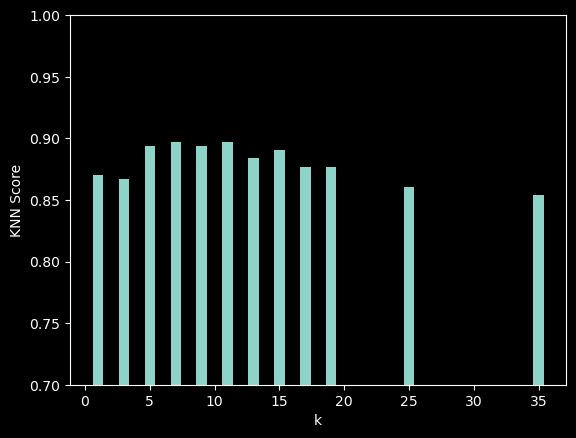

```
confusion_matrix :
 [[215   8   1]
 [ 10  36   0]
 [  0  12  19]]
classification_report :
               precision    recall  f1-score   support

           1       0.96      0.96      0.96       224
           2       0.64      0.78      0.71        46
           3       0.95      0.61      0.75        31

    accuracy                           0.90       301
   macro avg       0.85      0.79      0.80       301
weighted avg       0.91      0.90      0.90       301
```

</details>

confusion_matrix [[152   3   1]
 [ 12  13   0]
 [  0  11   9]]
classification_report               precision    recall  f1-score   support

           1       0.93      0.97      0.95       156
           2       0.48      0.52      0.50        25
           3       0.90      0.45      0.60        20

    accuracy                           0.87       201
   macro avg       0.77      0.65      0.68       201
weighted avg       0.87      0.87      0.86       201



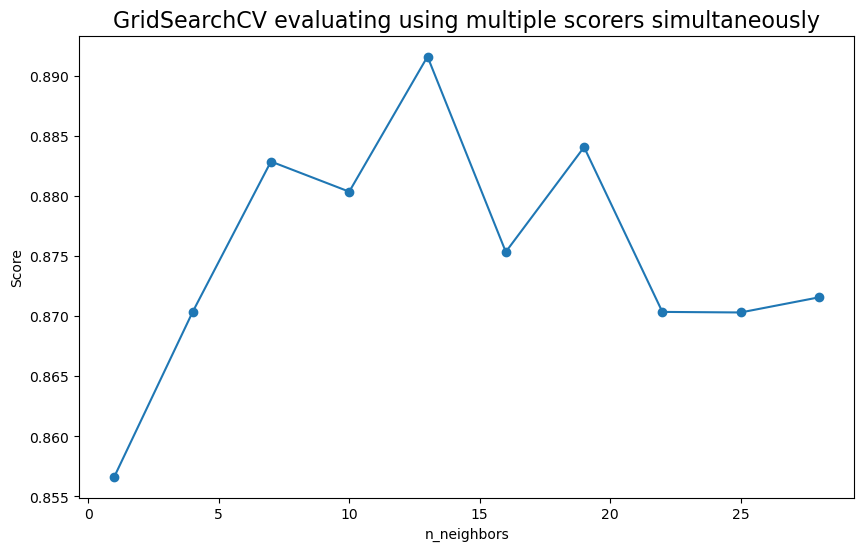

In [61]:
### START CODE HERE ###

knn_grid_param = {
    'n_neighbors': list(range(1, 30,3)),
    # 'weights': ['uniform', 'distance'],
    # 'metric': ['euclidean', 'manhattan']
}
model = KNeighborsClassifier()
knn_grid = GridSearchCV(model, knn_grid_param, cv=5, return_train_score=False)
knn_grid.fit(X_train, Y_train["Bean_grade"])

# Plot
plt.figure(figsize=(10, 6))
plt.title("GridSearchCV evaluating using multiple scorers simultaneously", fontsize=16)
plt.xlabel("n_neighbors")
plt.ylabel("Score")
plt.plot(knn_grid.cv_results_["param_n_neighbors"], knn_grid.cv_results_['mean_test_score'], label='euclidean_uniform', marker = 'o')

print("confusion_matrix", confusion_matrix(Y_test["Bean_grade"], knn_grid.predict(X_test)))
print("classification_report", classification_report(Y_test["Bean_grade"], knn_grid.predict(X_test)))
### END CODE HERE ###

### **Decision Tree Model Training and Testing**
Parameters 
- criterion = `['entropy', 'gini']`
- max_depth = `[4,5,6,None]`

Fit models with all this parameters.<br>
Then, print accuracy score of all parameter sets.<br>
Next, <font color="orange">plot the Tree, print confusion matrix and classification report</font> of best accuracy score for each criteion `entropy` and `gini`.

<details>

<summary>
<font size="3" color="green">
<b>Hints</b>
</font>
</summary>

- `DecisionTreeClassifier()`

</details>
<br>
<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical.

```
Accuracy is 0.8471760797342193 for criterion = entropy and max_depth = 4
...
Accuracy is 0.8504983388704319 for criterion = entropy and max_depth = None
Accuracy is 0.8504983388704319 for criterion = gini and max_depth = 4
...
Accuracy is 0.8338870431893688 for criterion = gini and max_depth = None
```



```Entropy Confusion Matrix:
 [[205  17   2]
 [ 10  30   6]
 [  1   5  25]]
Entropy Classification Report:
               precision    recall  f1-score   support

           1       0.95      0.92      0.93       224
           2       0.58      0.65      0.61        46
           3       0.76      0.81      0.78        31

    accuracy                           0.86       301
   macro avg       0.76      0.79      0.78       301
weighted avg       0.87      0.86      0.87       301

Gini Confusion Matrix:
 [[212  11   1]
 [ 18  27   1]
 [  2  12  17]]
Gini Classification Report:
               precision    recall  f1-score   support

           1       0.91      0.95      0.93       224
           2       0.54      0.59      0.56        46
           3       0.89      0.55      0.68        31

    accuracy                           0.85       301
   macro avg       0.78      0.69      0.72       301
weighted avg       0.85      0.85      0.85       301
```
</details>

confusion_matrix [[144  12   0]
 [  5  17   3]
 [  0   4  16]]
classification_report               precision    recall  f1-score   support

           1       0.97      0.92      0.94       156
           2       0.52      0.68      0.59        25
           3       0.84      0.80      0.82        20

    accuracy                           0.88       201
   macro avg       0.77      0.80      0.78       201
weighted avg       0.90      0.88      0.89       201



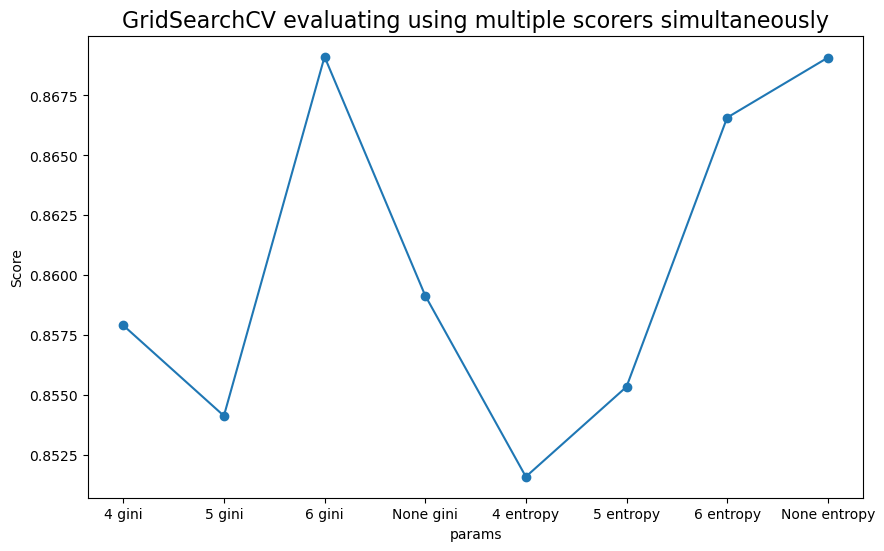

In [62]:
### START CODE HERE ###
dt_param_grid = {
    'max_depth': [4,5,6,None],
    "criterion": ["gini", "entropy"]
}
dt = DecisionTreeClassifier()
dt_grid = GridSearchCV(dt, dt_param_grid, cv=5, return_train_score=False)
dt_grid.fit(X_train, Y_train["Bean_grade"])

# Plot
plt.figure(figsize=(10, 6))
plt.title("GridSearchCV evaluating using multiple scorers simultaneously", fontsize=16)
plt.xlabel("params")
plt.ylabel("Score")
param1D = [f'{m} {c}' for m ,c in zip( dt_grid.cv_results_["param_max_depth"], dt_grid.cv_results_["param_criterion"] )]
plt.plot(param1D, dt_grid.cv_results_['mean_test_score'], label='euclidean_uniform', marker = 'o')
print("confusion_matrix", confusion_matrix(Y_test["Bean_grade"], dt_grid.predict(X_test)))
print("classification_report", classification_report(Y_test["Bean_grade"], dt_grid.predict(X_test)))
### END CODE HERE ###

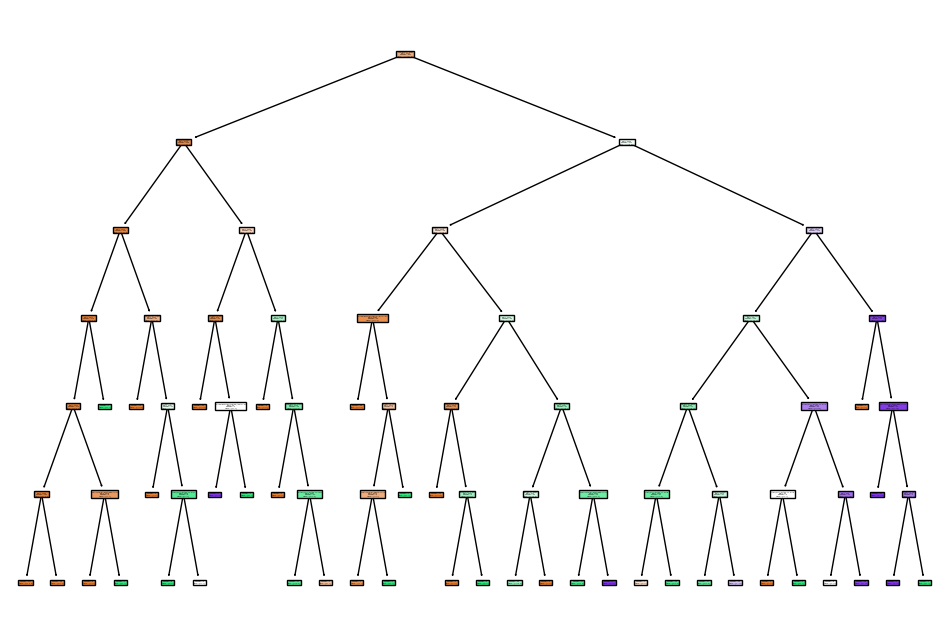

In [63]:
plt.figure(figsize=(12, 8))
tree.plot_tree(dt_grid.best_estimator_, feature_names=X.columns,  filled=True)
plt.show()


### **Random Forest Model Training and Testing**
Parameters 
- criterion = `['entropy', 'gini']`
- n_estimators = `[10,100]`

Fit models with all this parameters.<br>
Then, print accuracy score of all parameter sets.<br>
<details>

<summary>
<font size="3" color="green">
<b>Hints</b>
</font>
</summary>

- `RandomForestClassifier()`

</details>
<br>

<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical.
```
Accuracy is 0.8803986710963455 for criterion = entropy and n_estimators = 10
...
```

</details>

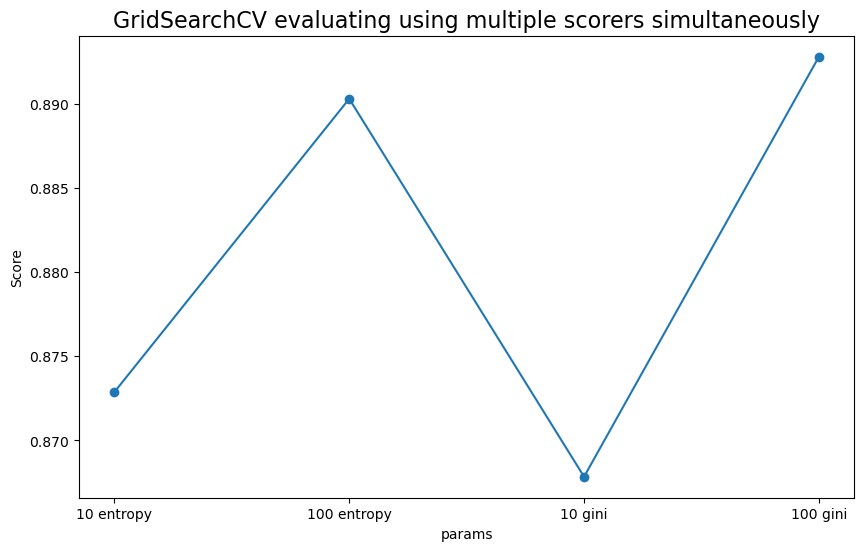

In [64]:
### START CODE HERE ###
rf_param_grid = {
    'n_estimators': [10, 100],
    "criterion": ["entropy","gini"]
}

rf = RandomForestClassifier()
rf_grid = GridSearchCV(rf, rf_param_grid, cv=5, return_train_score=False)
rf_grid.fit(X_train, Y_train["Bean_grade"])


# Plot
plt.figure(figsize=(10, 6))
plt.title("GridSearchCV evaluating using multiple scorers simultaneously", fontsize=16)
plt.xlabel("params")
plt.ylabel("Score")
param1D = [f'{m} {c}' for m ,c in zip( rf_grid.cv_results_["param_n_estimators"], rf_grid.cv_results_["param_criterion"] )]
plt.plot(param1D, rf_grid.cv_results_['mean_test_score'], label='euclidean_uniform', marker = 'o')
### END CODE HERE ###

**Print confusion matrix and classification report of best accuracy score.**
<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical.
```
confusion_matrix :
 [[219   4   1]
 [ 13  31   2]
 [  0  10  21]]
classification_report :
               precision    recall  f1-score   support

           1       0.94      0.98      0.96       224
           2       0.69      0.67      0.68        46
           3       0.88      0.68      0.76        31

    accuracy                           0.90       301
   macro avg       0.84      0.78      0.80       301
weighted avg       0.90      0.90      0.90       301
```

</details>

In [65]:
from sklearn.metrics import confusion_matrix, classification_report
### START CODE HERE ###

# Predict the target variable using the rf_grid model
y_pred = rf_grid.predict(X_test)

# Compute the confusion matrix
cm = confusion_matrix(Y_test["Bean_grade"], y_pred)
print("Confusion matrix:\n", cm)

# Compute the classification report
cr = classification_report(Y_test["Bean_grade"], y_pred)
print("Classification report:\n", cr)


### END CODE HERE ###

Confusion matrix:
 [[152   4   0]
 [ 10  13   2]
 [  0   8  12]]
Classification report:
               precision    recall  f1-score   support

           1       0.94      0.97      0.96       156
           2       0.52      0.52      0.52        25
           3       0.86      0.60      0.71        20

    accuracy                           0.88       201
   macro avg       0.77      0.70      0.73       201
weighted avg       0.88      0.88      0.88       201



**Plot bar graph of feature_importance of best models.**
<details>

<summary>
<font size="3" color="green">
<b>Hints</b>
</font>
</summary>

- `.feature_importances_`

</details>
<br>

<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical.

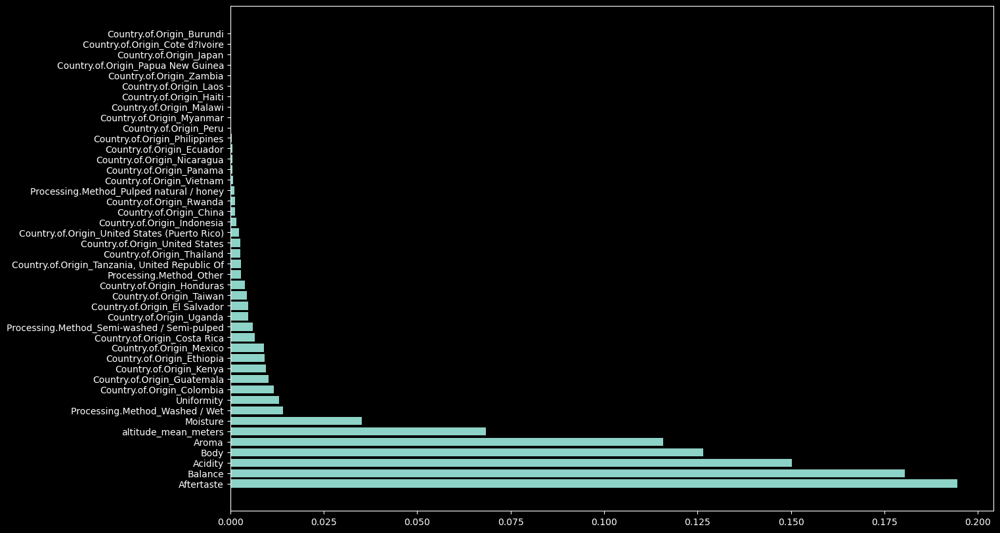


</details>

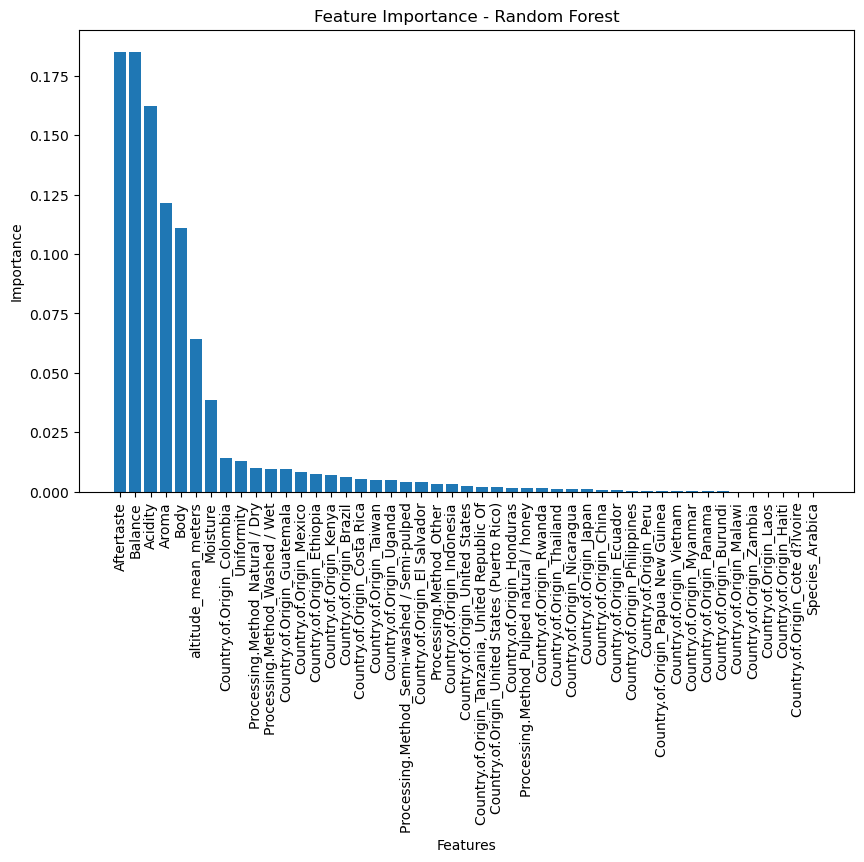

In [66]:
import matplotlib.pyplot as plt

# Access the feature importances of the best models
rf_feature_importances = rf_grid.best_estimator_.feature_importances_

# Sort the feature importances in descending order
sorted_indices = rf_feature_importances.argsort()[::-1]
sorted_importances = rf_feature_importances[sorted_indices]

# Plot the bar graph
plt.figure(figsize=(10, 6))
plt.bar(X.columns[sorted_indices], sorted_importances)
plt.xlabel('Features')
plt.ylabel('Importance')
plt.title('Feature Importance - Random Forest')
plt.xticks(rotation=90)
plt.show()


**Plot tree of all forest**<br>
NOTE: Please use high DPI for easier observation of the forest.
<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical.




</details>

In [67]:
from sklearn import tree
### START CODE HERE ###
import matplotlib.pyplot as plt
# Access the individual decision trees in the random forest
estimators = rf_grid.best_estimator_.estimators_

for i in range(5):  # Change this to plot more or fewer trees
    plt.figure(figsize=(20, 10), dpi=1200)  # Set the DPI resolution to 300
    tree.plot_tree(estimators[i], filled=True)
    plt.title(f"Tree {i+1}")
    plt.show()
### END CODE HERE ###

### **MLP Training and Testing**
Parameters
 - hidden_layer_sizes = `(10,10,)`

Fit models with this parameters.<br>
Then, print accuracy score, confusion matrix and classification report.<br>
<details>

<summary>
<font size="3" color="green">
<b>Hints</b>
</font>
</summary>

- `MLPClassifier()`

</details>
<br>

<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical.
```
Accuracy is 0.9036544850498339
Confusion Matrix:
 [[211  13   0]
 [  6  37   3]
 [  0   7  24]]
Classification Report:
               precision    recall  f1-score   support

           1       0.97      0.94      0.96       224
           2       0.65      0.80      0.72        46
           3       0.89      0.77      0.83        31

    accuracy                           0.90       301
   macro avg       0.84      0.84      0.83       301
weighted avg       0.91      0.90      0.91       301
...
```
</details>

In [68]:
### START CODE HERE ###
mlp = MLPClassifier(hidden_layer_sizes=(10,10,))
mlp.fit(X_train, Y_train["Bean_grade"])
y_pred = mlp.predict(X_test)
accuracy = accuracy_score(Y_test["Bean_grade"], y_pred)
print("Accuracy:", accuracy)
print(classification_report(Y_test["Bean_grade"], y_pred))
print(confusion_matrix(Y_test["Bean_grade"], y_pred))   

### END CODE HERE ###

Accuracy: 0.9154228855721394
              precision    recall  f1-score   support

           1       0.94      0.97      0.96       156
           2       0.71      0.60      0.65        25
           3       0.89      0.85      0.87        20

    accuracy                           0.92       201
   macro avg       0.85      0.81      0.83       201
weighted avg       0.91      0.92      0.91       201

[[152   3   1]
 [  9  15   1]
 [  0   3  17]]


/home/ss/.conda/envs/ML_Lab/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


### **Hyperparameter Tuning (GridsearchCV)**
Search space for KNN
- n_neighhbors = `[1,3,5,7,9,11,13,15,17,19,25,35,45]`

Search space for Decision Tree
- criterion = `['entropy', 'gini']`
- max_depth = `[4,5,6]`
- max_features = `['sqrt', 'log2',None]`
- min_samples_leaf = `[1,2,4]`

Search space for Random forest
- criterion = `['entropy', 'gini']`
- max_depth = `[4,5,6]`
- max_features = `['sqrt', 'log2',None]`
- min_samples_leaf = `[1,2,4]`
- n_estimators = `[10,30,50,100]`

Search space for MLP
- hidden_layer_sizes = `[(2,2,), (20,20,), (50,50,)]`
- n_iter = `[100,200,300]`

Then run grid search.

<details>

<summary>
<font size="3" color="green">
<b>Hints</b>
</font>
</summary>

- `GridSearchCV()`

</details>
<br>


In [69]:
### START CODE HERE ###

from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier

# Define the hyperparameters
knn_params = {'n_neighbors': [1,3,5,7,9,11,13,15,17,19,25,35,45]}
dt_params = {'criterion': ['entropy', 'gini'], 'max_depth': [4,5,6], 'max_features': ['sqrt', 'log2', None], 'min_samples_leaf': [1,2,4]}
rf_params = {'criterion': ['entropy', 'gini'], 'max_depth': [4,5,6], 'max_features': ['sqrt', 'log2', None], 'min_samples_leaf': [1,2,4], 'n_estimators': [10,30,50,100]}
mlp_params = {'hidden_layer_sizes': [(2,2,), (20,20,), (50,50,)], 'max_iter': [100,200,300]}

# Define the models
knn = KNeighborsClassifier()
dt = DecisionTreeClassifier()
rf = RandomForestClassifier()
mlp = MLPClassifier()

# Perform GridSearchCV
knn_gs = GridSearchCV(knn, knn_params, cv=5)
dt_gs = GridSearchCV(dt, dt_params, cv=5)
rf_gs = GridSearchCV(rf, rf_params, cv=5)
mlp_gs = GridSearchCV(mlp, mlp_params, cv=5)

# Fit the models
knn_gs.fit(X_train, Y_train["Bean_grade"])
dt_gs.fit(X_train, Y_train["Bean_grade"])
rf_gs.fit(X_train, Y_train["Bean_grade"])
mlp_gs.fit(X_train, Y_train["Bean_grade"])

### END CODE HERE ###


/home/ss/.conda/envs/ML_Lab/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/ss/.conda/envs/ML_Lab/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/ss/.conda/envs/ML_Lab/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/ss/.conda/envs/ML_Lab/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/ss/.conda/

GridSearchCV(cv=5, estimator=MLPClassifier(),
             param_grid={'hidden_layer_sizes': [(2, 2), (20, 20), (50, 50)],
                         'max_iter': [100, 200, 300]})

**Print the result of grid search.**<br>
- Best parameters of each models
- Best scores of each models
- Mean score
- std scored
- Parameters<br>

**Plot bar graph to show accuracy score of each models.**


<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical.
```
Best parameters: {'n_neighbors': 9}
Best score: 0.8803444782168187
Mean cross-validated score: [0.85893617 0.85036474 0.86322188 0.87893617 0.88034448 0.87463019
 0.86751773 0.86753799 0.86895643 0.86755826 0.85758865 0.86754813
 0.86471125]
Standard deviation of cross-validated score: [0.02615339 0.02804864 0.00870862 0.01734425 0.01932745 0.01472621
 0.00729099 0.00693851 0.00838998 0.01430598 0.01142008 0.01030234
 0.01525526]
Parameters: [{'n_neighbors': 1}, {'n_neighbors': 3}, {'n_neighbors': 5}, {'n_neighbors': 7}, {'n_neighbors': 9}, {'n_neighbors': 11}, {'n_neighbors': 13}, {'n_neighbors': 15}, {'n_neighbors': 17}, {'n_neighbors': 19}, {'n_neighbors': 25}, {'n_neighbors': 35}, {'n_neighbors': 45}]
...
```

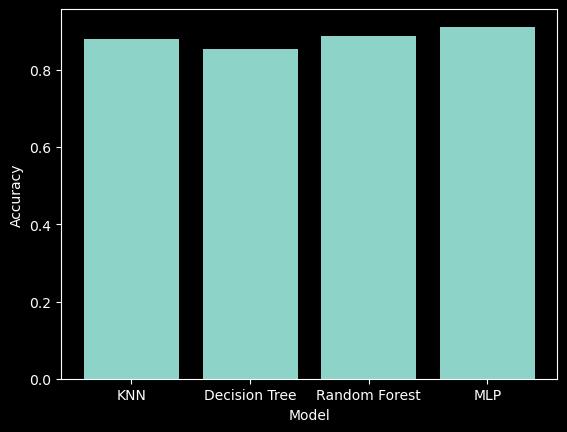
</details>

KNN Results
Best parameters: {'n_neighbors': 13}
Best score: 0.8915838509316769
Mean cross-validated score: [0.85665373 0.86909161 0.87534938 0.88285714 0.87539596 0.87911491
 0.89158385 0.88034938 0.87907609 0.8840528  0.8703028  0.86406832
 0.85783385]
Standard deviation of cross-validated score: [0.0290566  0.02580772 0.02444239 0.02567826 0.03336469 0.02915155
 0.02781428 0.03022351 0.02135285 0.01499359 0.03416318 0.03253308
 0.03004029]
Parameters: [{'n_neighbors': 1}, {'n_neighbors': 3}, {'n_neighbors': 5}, {'n_neighbors': 7}, {'n_neighbors': 9}, {'n_neighbors': 11}, {'n_neighbors': 13}, {'n_neighbors': 15}, {'n_neighbors': 17}, {'n_neighbors': 19}, {'n_neighbors': 25}, {'n_neighbors': 35}, {'n_neighbors': 45}]

Decision Tree Results
Best parameters: {'criterion': 'gini', 'max_depth': 4, 'max_features': None, 'min_samples_leaf': 4}
Best score: 0.8715916149068322
Mean cross-validated score: [0.78684783 0.81924689 0.82174689 0.77564441 0.77680124 0.76064441
 0.85159938 0.85159938 

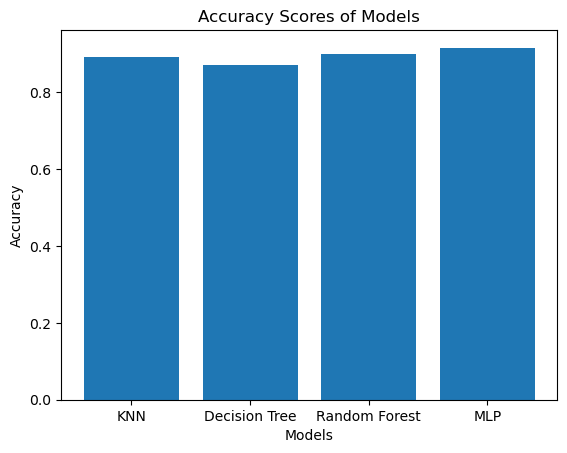

In [70]:
### START CODE HERE ###

import matplotlib.pyplot as plt
import numpy as np

# Define a function to print the results
def print_results(gs):
    print("Best parameters:", gs.best_params_)
    print("Best score:", gs.best_score_)
    print("Mean cross-validated score:", gs.cv_results_['mean_test_score'])
    print("Standard deviation of cross-validated score:", gs.cv_results_['std_test_score'])
    print("Parameters:", gs.cv_results_['params'])

# Print the results for each model
print("KNN Results")
print_results(knn_gs)

print("\nDecision Tree Results")
print_results(dt_gs)

print("\nRandom Forest Results")
print_results(rf_gs)

print("\nMLP Results")
print_results(mlp_gs)

# Plot the accuracy scores
models = ['KNN', 'Decision Tree', 'Random Forest', 'MLP']
scores = [knn_gs.best_score_, dt_gs.best_score_, rf_gs.best_score_, mlp_gs.best_score_]

plt.bar(models, scores)
plt.xlabel('Models')
plt.ylabel('Accuracy')
plt.title('Accuracy Scores of Models')
plt.show()

### END CODE HERE ###


**Plot the confusion matrix for each model's best parameters.**
<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical.

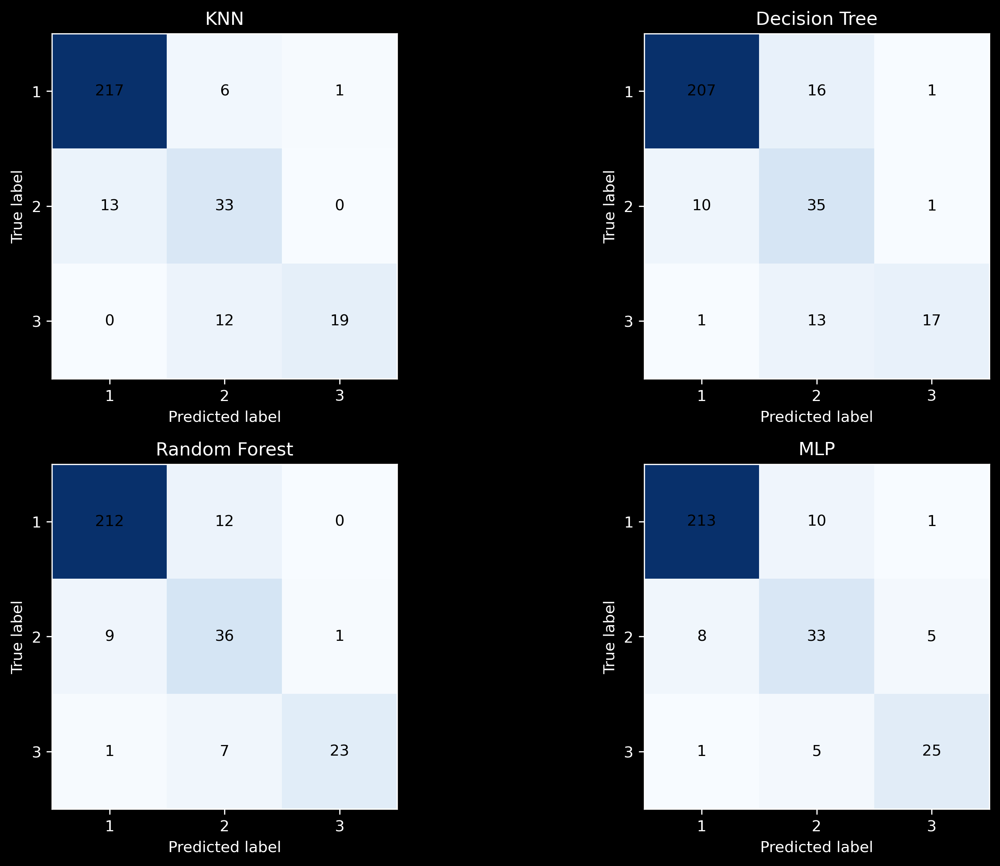


</details>

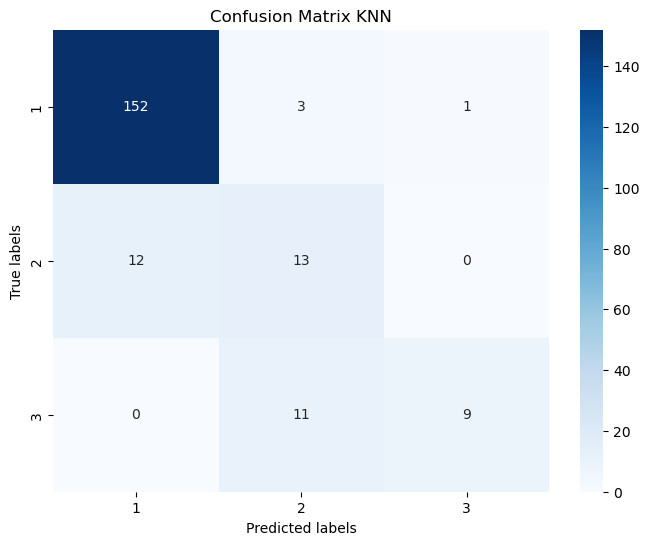

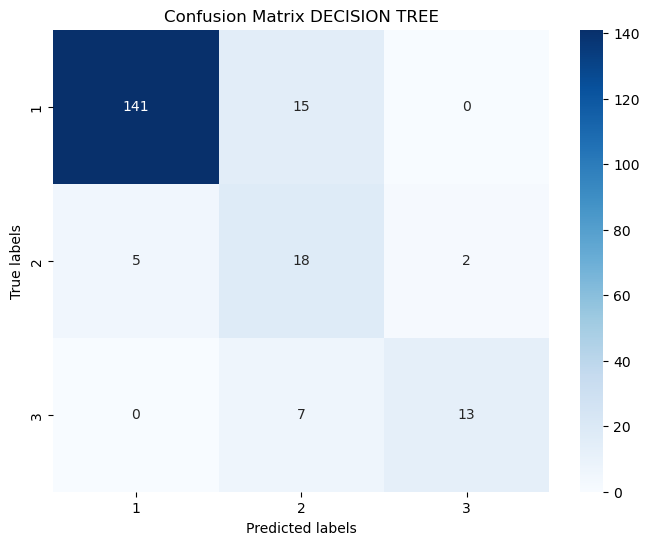

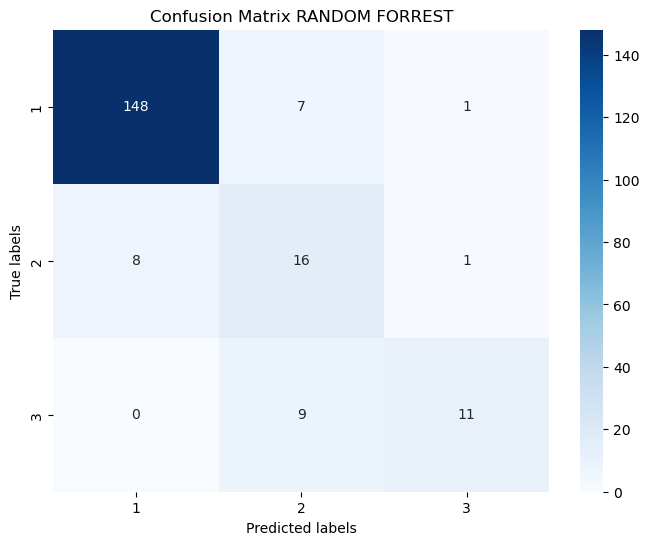

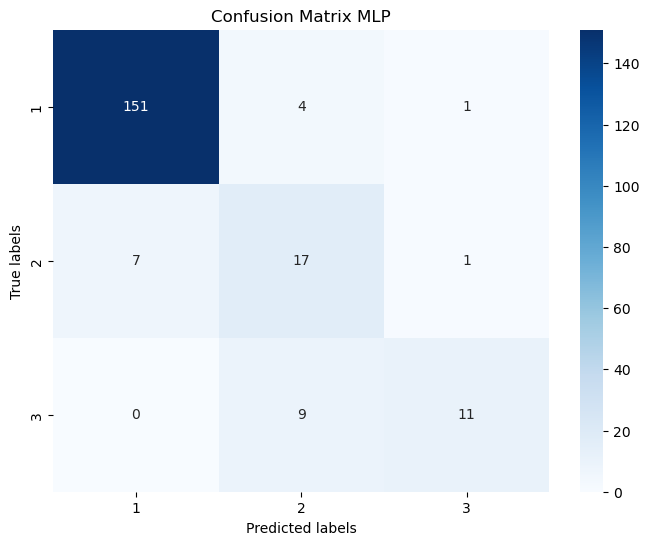

In [71]:
### START CODE HERE ###
# Define a function to plot the confusion matrix
def plot_cm(model_name, model, X, y):
    # Generate predictions
    y_pred = model.predict(X)
    # Compute confusion matrix
    cm = confusion_matrix(y, y_pred)
    
    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", 
                xticklabels=model.classes_,
                yticklabels=model.classes_)
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')
    plt.title(f'Confusion Matrix {model_name}')
    plt.show()
    

# Plot the confusion matrix for each model's best parameters
plot_cm("KNN",knn_gs.best_estimator_, X_test, Y_test["Bean_grade"])
plot_cm("DECISION TREE",dt_gs.best_estimator_, X_test, Y_test["Bean_grade"])
plot_cm("RANDOM FORREST",rf_gs.best_estimator_, X_test, Y_test["Bean_grade"])
plot_cm("MLP",mlp_gs.best_estimator_, X_test, Y_test["Bean_grade"])


### END CODE HERE ###